# Домашнє завдання 4

### 1. Завантаження даних

In [57]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.datasets import load_breast_cancer
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import pairwise_distances
import numpy as np

In [58]:
data = load_breast_cancer()
X = data.data
y = data.target
feature_names = data.feature_names

print(f"Набір даних завантажено. Кількість зразків: {X.shape[0]}, Кількість ознак: {X.shape[1]}")
# print(data.DESCR) # повний опис
print("data.feature_names:", feature_names)
print("\n" + "="*50 + "\n")

Набір даних завантажено. Кількість зразків: 569, Кількість ознак: 30
data.feature_names: ['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']




### 2. Створення dataframe

In [59]:
df = pd.DataFrame(X, columns=feature_names)
df['target'] = y # Додаємо цільову змінну (0 - malignant, 1 - benign)
df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


### 3. Інформація про дані

In [60]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

### 4. Описові статистики

In [61]:
df.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.627417
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,1.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


### 5. Стандартизація

In [62]:
def data_scale(data, scaler_type='minmax'):
    from sklearn.preprocessing import MinMaxScaler
    from sklearn.preprocessing import StandardScaler
    from sklearn.preprocessing import Normalizer
    if scaler_type == 'minmax':
        scaler = MinMaxScaler()
    if scaler_type == 'std':
        scaler = StandardScaler()
    if scaler_type == 'norm':
        scaler = Normalizer()

    scaler.fit(data)
    res = scaler.transform(data)
    return res


In [63]:
# Відокремлюємо ознаки (X) для стандартизації
X_features = df.drop('target', axis=1)
X_scaled = data_scale(X_features, scaler_type='std')

# Створюємо новий DataFrame зі стандартизованими даними
df_scaled = pd.DataFrame(X_scaled, columns=feature_names)
df_scaled['target'] = y
df_scaled.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015,0
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190,0
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391,0
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010,0
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100,0


### 6. Парні графіки для ознак

In [50]:
from IPython.display import Image, display

# Виводимо зображення
print("Примітка: результат побудови pairplot для всіх 30 ознак - у вкладеному файлі.")
display(Image(filename='pairplot_all.png'))

Примітка: результат побудови pairplot для всіх 30 ознак - у вкладеному файлі.


Pairplot для деяких ознак.



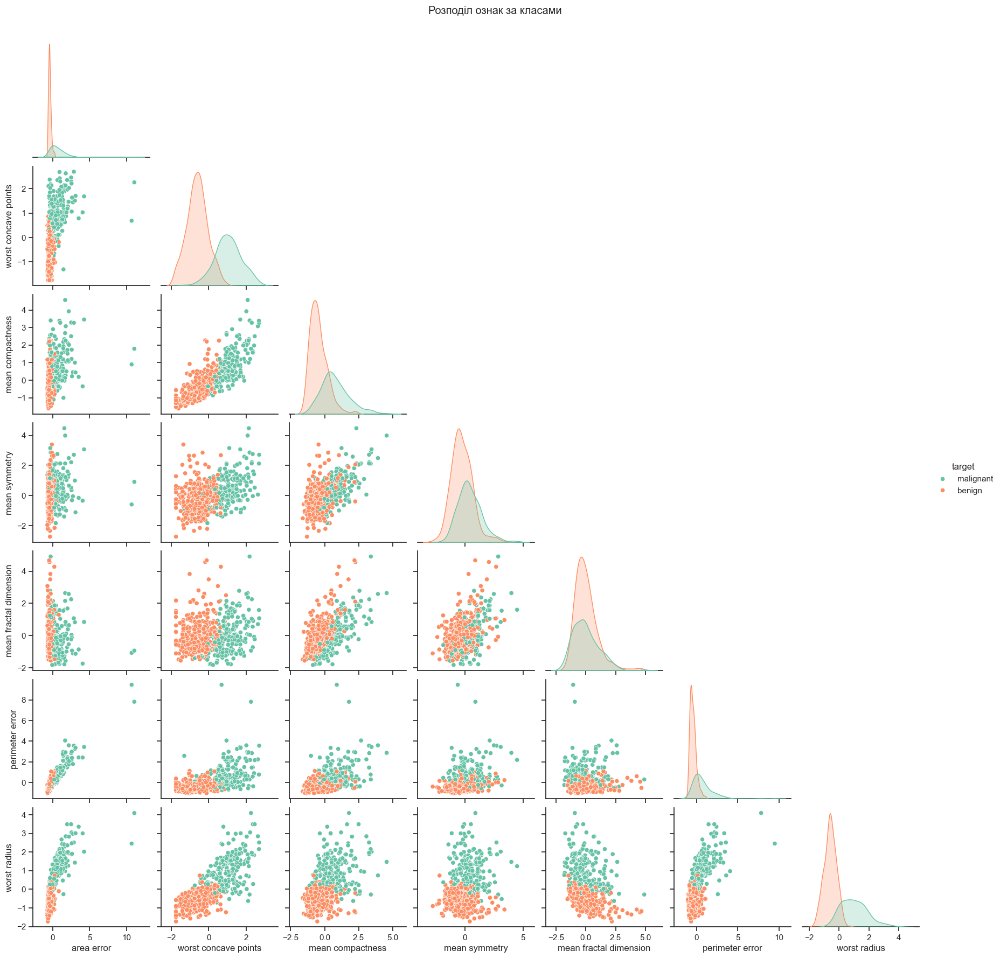

In [64]:
print("Pairplot для деяких ознак.\n")

# Вибираємо підмножину ознак для побудови pairplot
cols_for_plot = ['area error', 'worst concave points', 'mean compactness', 
                 'mean symmetry', 'mean fractal dimension', 'perimeter error', 
                 'worst radius']

df_subset = df_scaled[cols_for_plot].copy()
df_subset['target'] = df_scaled['target'].apply(lambda x: 'benign' if x == 1 else 'malignant')

sns.pairplot(df_subset, hue='target', palette='Set2', corner=True)

sns.set_theme(style="ticks")
plt.suptitle("Розподіл ознак за класами", y=1.02)
plt.show()

### 7. Матриця відстаней

In [67]:
# Повна матриця 569x569 є великою для візуалізації.
# Для демонстрації розрахунку та візуалізації візьмемо меншу вибірку 
# (з випадкових 100 зразків) зі стандартизованих даних (X_scaled).

# Вибираємо 100 випадкових зразків
sample_size = 100
n_samples = X_scaled.shape[0]

random_indices = np.random.choice(n_samples, sample_size, replace=False)
random_indices.sort()

data_sample = X_scaled[random_indices, :]
print(f"Використовуємо {sample_size} випадкових зразків для розрахунку відстаней.")

dist_euclidean = pairwise_distances(data_sample, metric='euclidean')
dist_manhattan = pairwise_distances(data_sample, metric='manhattan')
dist_cityblock = pairwise_distances(data_sample, metric='cityblock')
dist_l1 = pairwise_distances(data_sample, metric='l1')
dist_cosine = pairwise_distances(data_sample, metric='cosine')

# словник для зручного доступу до матриць відстаней
distance_matrices = {
    'euclidean': dist_euclidean,
    'manhattan': dist_manhattan,
    'cityblock': dist_cityblock,
    'l1': dist_l1,
    'cosine': dist_cosine
}

print(f" - euclidean (перші 3х3 випадкової вибірки): \n{dist_euclidean[:3, :3]}\n")
print(f" - manhattan (перші 3х3 випадкової вибірки): \n{dist_manhattan[:3, :3]}\n")
print(f" - cityblock (перші 3х3 випадкової вибірки): \n{dist_cityblock[:3, :3]}\n")
print(f" - l1 (перші 3х3 випадкової вибірки): \n{dist_l1[:3, :3]}\n")
print(f" - cosine (перші 3х3 випадкової вибірки): \n{dist_cosine[:3, :3]}\n")

Використовуємо 100 випадкових зразків для розрахунку відстаней.
 - euclidean (перші 3х3 випадкової вибірки): 
[[0.         5.0320153  8.64377929]
 [5.0320153  0.         6.89110887]
 [8.64377929 6.89110887 0.        ]]

 - manhattan (перші 3х3 випадкової вибірки): 
[[ 0.         23.06903905 39.94847391]
 [23.06903905  0.         31.28577108]
 [39.94847391 31.28577108  0.        ]]

 - cityblock (перші 3х3 випадкової вибірки): 
[[ 0.         23.06903905 39.94847391]
 [23.06903905  0.         31.28577108]
 [39.94847391 31.28577108  0.        ]]

 - l1 (перші 3х3 випадкової вибірки): 
[[ 0.         23.06903905 39.94847391]
 [23.06903905  0.         31.28577108]
 [39.94847391 31.28577108  0.        ]]

 - cosine (перші 3х3 випадкової вибірки): 
[[0.         0.38768909 1.26316701]
 [0.38768909 0.         0.67456216]
 [1.26316701 0.67456216 0.        ]]



### 8. Візуалізація матриць відстаней

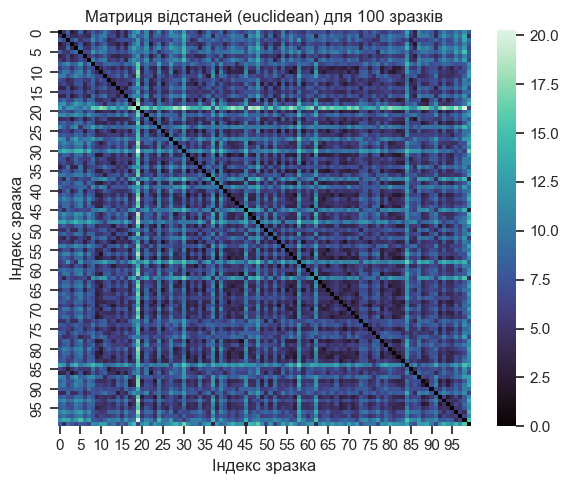

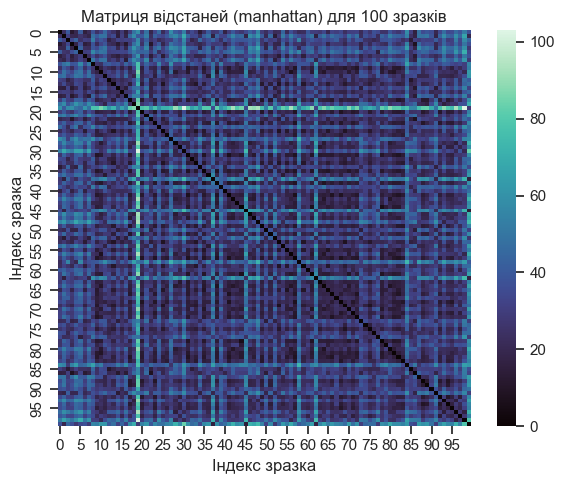

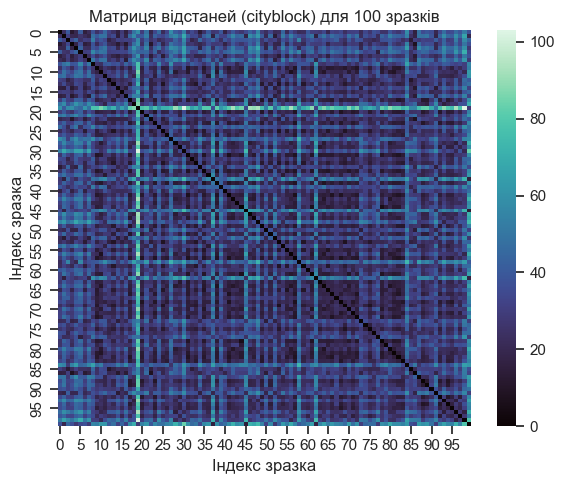

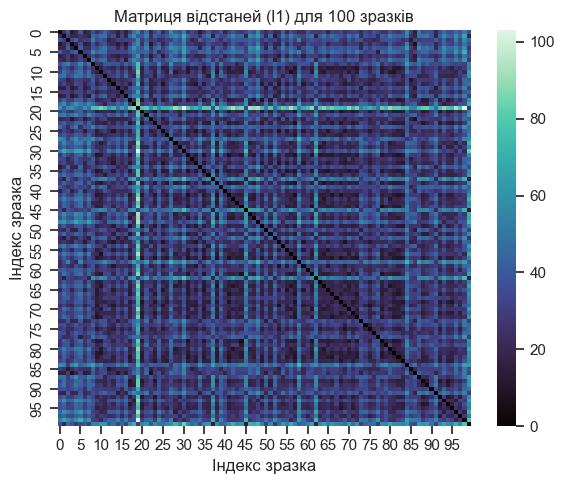

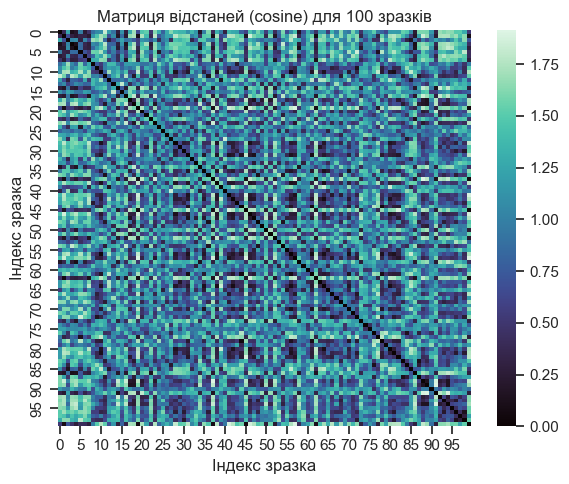

In [68]:
for metric_name, matrix in distance_matrices.items():
    plt.figure(figsize=(6, 5))
    sns.heatmap(matrix, cmap='mako')
    plt.title(f"Матриця відстаней ({metric_name}) для {sample_size} зразків")
    plt.xlabel("Індекс зразка")
    plt.ylabel("Індекс зразка")
    plt.tight_layout()
    plt.show()


### 9. Висновок

In [73]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, adjusted_rand_score

# Cправжні мітки для наших 100 випадкових зразків з датасету-джерела
y_sample = y[random_indices]

# Встановлюємо 2 кластери (malignant/benign)
n_clusters = 2

for metric_name, matrix in distance_matrices.items():
    model = AgglomerativeClustering(
        n_clusters=n_clusters,
        metric='precomputed',
        linkage='average'
    )
    
    pred_labels = model.fit_predict(matrix)
    
    # silhouette_score вимагає матрицю відстаней та мітки
    silhouette_avg = silhouette_score(matrix, pred_labels, metric='precomputed')
    # Порівнюємо отримані 'pred_labels' з реальними 'y_sample'
    ari = adjusted_rand_score(y_sample, pred_labels)

    print(f"{metric_name:<10} ARI = {ari:.4f}, Silhouette = {silhouette_avg:.4f}")




euclidean  ARI = 0.0171, Silhouette = 0.4839
manhattan  ARI = 0.0171, Silhouette = 0.5270
cityblock  ARI = 0.0171, Silhouette = 0.5270
l1         ARI = 0.0171, Silhouette = 0.5270
cosine     ARI = 0.8066, Silhouette = 0.4340


Всі карти, окрім карти по метриці cosine - між собою ідентичні. 

У певних місцях проглядається схожість між собою зразків 0-7, 63-72, саме там бачимо схожі за тоном кольори невеликих квадратів як на euclidian, manhattan та інших, так і на cosine.


тим не мерш за оцінками результатів, виходить, що метрики за відстанями - не сильно прийнятні для класивікації цих даних, окрім візуального шуму на теплових картах, показники оцінки AgglomerativeClustering показують дуже низький результат 0.0171.

В той час групування за косинусною відстанню показує значно вищу оцінку 0.8066, і дійсно по ций метриці навіть на тепловій карті частіше проглядаються контрастні блоки кластерів.

Для представленої вибірки даних напрямок векторів ознак (який вимірює cosine) виявився незрівнянно важливішим для класифікації, ніж їхня абсолютна "відстань" (яку вимірюють euclidean та manhattan та інші).